# GANs and VAEs from scratch

## Setting up working environment

In [1]:
!pip install -q torch torchvision altair seaborn
!pip install altair_saver
from pathlib import Path
import tqdm

fatal: destination path 'icl_dl_cw2_utils' already exists and is not an empty directory.
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


# Part 1 - Variational Autoencoder

In [3]:
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
import torch.nn.functional as F
import matplotlib.pyplot as plt

def show(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))

if not os.path.exists(content_path/'VAE/'):
    os.makedirs(content_path/'VAE/')

if not os.path.exists(data_path):
    os.makedirs(data_path)

# We set a random seed to ensure that your results are reproducible.
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

GPU = True # Choose whether to use GPU
if GPU:
    device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")
else:
    device = torch.device("cpu")
print(f'Using {device}')

Using cuda


---
## Part 1.1a: Implement VAE (25 Points)
### Hyper-parameter selection


In [4]:
# Necessary Hyperparameters 
num_epochs = 20
learning_rate = 5e-4
batch_size = 128
latent_dim = 8 

# Additional Hyperparameters 
transform = transforms.Compose([
    transforms.ToTensor(),
#     transforms.Normalize([0.13066062], [0.30810776])
])

def denorm(x):
    return x

### Data loading


In [5]:
train_dat = datasets.MNIST(
    data_path, train=True, download=True, transform=transform
)
test_dat = datasets.MNIST(data_path, train=False, transform=transform)

loader_train = DataLoader(train_dat, batch_size, shuffle=True)
loader_test = DataLoader(test_dat, batch_size, shuffle=False)

sample_inputs, _ = next(iter(loader_test))
fixed_input = sample_inputs[:32, :, :, :]
save_image(fixed_input, content_path/'VAE/image_original.png')

### Model Definition

<figure>
  <img src="https://blog.bayeslabs.co/assets/img/vae-gaussian.png" style="width:60%">
  <figcaption>
    Fig.1 - VAE Diagram (with a Guassian prior), taken from <a href="https://blog.bayeslabs.co/2019/06/04/All-you-need-to-know-about-Vae.html">1</a>.
  </figcaption>
</figure>

In [6]:
class VAE(nn.Module):
    def __init__(self, latent_dim):
        super(VAE, self).__init__()
        self.feature_dim = 64*20*20
        self.encConv1 = nn.Conv2d(1, 16, 5)
        self.bn_encode1 = nn.BatchNorm2d(16)
        self.encConv2 = nn.Conv2d(16, 64, 5)
        self.bn_encode2 = nn.BatchNorm2d(64)
        self.encFC1 = nn.Linear(self.feature_dim, latent_dim)
        self.encFC2 = nn.Linear(self.feature_dim, latent_dim)

        self.decFC1 = nn.Linear(latent_dim, self.feature_dim)
        self.decConv1 = nn.ConvTranspose2d(64, 16, 5)
        self.bn_decode1 = nn.BatchNorm2d(16)
        self.decConv2 = nn.ConvTranspose2d(16, 1, 5)
        
    def encode(self, x):
        x = F.relu(self.bn_encode1(self.encConv1(x)))
        x = F.relu(self.bn_encode2(self.encConv2(x)))
        x = x.view(-1, 64*20*20)
        mu = self.encFC1(x)
        logvar = self.encFC2(x)
        return mu, logvar
    
    def reparametrize(self, mu, logvar):
        std = torch.exp(logvar/2)
        eps = torch.randn_like(std)
        return mu + std * eps

    def decode(self, z):
        z = F.relu(self.decFC1(z))
        z = z.view(-1, 64, 20, 20)
        z = F.relu(self.bn_decode1(self.decConv1(z)))
        z = torch.sigmoid(self.decConv2(z))
        return z
    
    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparametrize(mu, logvar)
        out = self.decode(z)
        return out, mu, logvar

model = VAE(latent_dim).to(device)
params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters is: {}".format(params))
print(model)
# optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

Total number of parameters is: 692305
VAE(
  (encConv1): Conv2d(1, 16, kernel_size=(5, 5), stride=(1, 1))
  (bn_encode1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (encConv2): Conv2d(16, 64, kernel_size=(5, 5), stride=(1, 1))
  (bn_encode2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (encFC1): Linear(in_features=25600, out_features=8, bias=True)
  (encFC2): Linear(in_features=25600, out_features=8, bias=True)
  (decFC1): Linear(in_features=8, out_features=25600, bias=True)
  (decConv1): ConvTranspose2d(64, 16, kernel_size=(5, 5), stride=(1, 1))
  (bn_decode1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (decConv2): ConvTranspose2d(16, 1, kernel_size=(5, 5), stride=(1, 1))
)


--- 

## Part 1.1b: Training the Model (5 Points)

### Defining a Loss
We are going to use the Beta VAE loss, with an encoder $q$ and decoder $p$:
$$ \mathcal{L}=\mathbb{E}_{q_\phi(z \mid X)}[\log p_\theta(X \mid z)]-\beta D_{K L}[q_\phi(z \mid X) \| p_\theta(z)]$$

In [7]:
def loss_function_VAE(recon_x, x, mu, logvar, beta):
        kl_divergence = 0.5 * torch.sum(-1 - logvar + mu.pow(2) + logvar.exp())
        recon_loss = F.binary_cross_entropy(recon_x, x, size_average=False)
        loss =  recon_loss + beta * kl_divergence
        return loss, kl_divergence, recon_loss
  
    
def run_model(model, optimizer, beta, learning_rate, num_epochs, latent_dim):
    model.train()
    
    loss_list, kl_divergence_list, recon_loss_list = [], [], []
    loss_list_test, kl_divergence_list_test, recon_loss_list_test = [], [], []
    for epoch in range(num_epochs):  
        
        with tqdm.tqdm(loader_train, unit="batch") as tepoch: 
            loss_temp, kl_temp, recon_temp = 0, 0, 0
            for batch_idx, (data, _) in enumerate(tepoch):   
               
                data = data.to(device=device) # Need at least one batch/random data with right shape -
                            # This is required to initialize to model properly below
                            # when we save the computational graph for testing (jit.save)
                recon_x, mu, logvar = model.forward(data)
                loss, kl_divergence, recon_loss = loss_function_VAE(recon_x, data, mu, logvar, beta)

                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
                
                loss_temp += loss.cpu().detach().numpy()
                kl_temp += kl_divergence.cpu().detach().numpy()
                recon_temp += recon_loss.cpu().detach().numpy()

                if batch_idx % 20 == 0:
                    tepoch.set_description(f"Epoch {epoch}")
                    tepoch.set_postfix(loss=loss.item()/len(data))
        loss_list.append(loss_temp/(len(data)*496))
        kl_divergence_list.append(kl_temp/(len(data)*496))
        recon_loss_list.append(recon_temp/(len(data)*496))


        with tqdm.tqdm(loader_test, unit="batch") as tepoch: 
            loss_temp, kl_temp, recon_temp = 0, 0, 0
            for batch_idx, (test_data, _) in enumerate(tepoch):
                test_data = test_data[0][None, :, :].to(device=device)
                out_test, mu, logvar = model.forward(test_data)
                loss_test, kl_divergence_test, recon_loss_test = loss_function_VAE(out_test, test_data, mu, logvar, beta)
                loss_temp += loss_test.cpu().detach().numpy()
                kl_temp += kl_divergence_test.cpu().detach().numpy()
                recon_temp += recon_loss_test.cpu().detach().numpy()
        
        loss_list_test.append(loss_temp/100)
        kl_divergence_list_test.append(kl_temp/100)
        recon_loss_list_test.append(recon_temp/100)
        
    path_str = 'VAE/VAE_model.pth'
    if epoch == num_epochs - 1:
        with torch.no_grad():
            torch.jit.save(torch.jit.trace(model, (data), check_trace=False),
                content_path/path_str)
    return model, loss_list, kl_divergence_list, recon_loss_list, loss_list_test, kl_divergence_list_test, recon_loss_list_test

Beta is 2


100%|██████████| 79/79 [00:00<00:00, 106.39batch/s]
/opt/conda/lib/python3.8/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


Input images
--------------------------------------------------
Reconstructed images
--------------------------------------------------
Generated Images
--------------------------------------------------
Beta is 1


100%|██████████| 79/79 [00:00<00:00, 107.08batch/s]


Input images
--------------------------------------------------
Reconstructed images
--------------------------------------------------
Generated Images
--------------------------------------------------
Beta is 0.5


100%|██████████| 79/79 [00:00<00:00, 105.91batch/s]


Input images
--------------------------------------------------
Reconstructed images
--------------------------------------------------
Generated Images
--------------------------------------------------
Beta is 4


100%|██████████| 79/79 [00:00<00:00, 104.25batch/s]


Input images
--------------------------------------------------
Reconstructed images
--------------------------------------------------
Generated Images
--------------------------------------------------


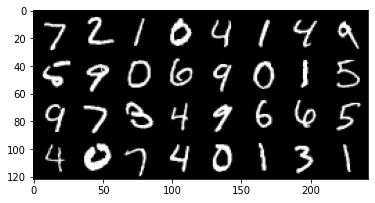

<Figure size 432x288 with 0 Axes>

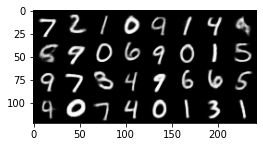

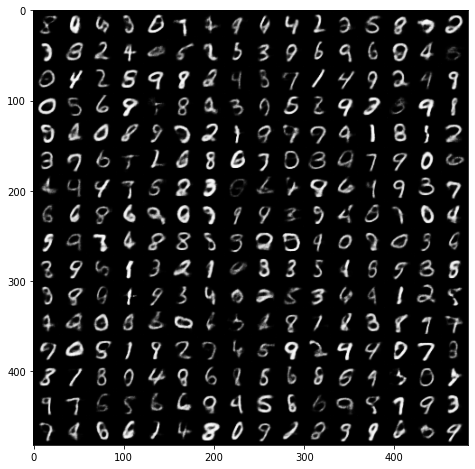

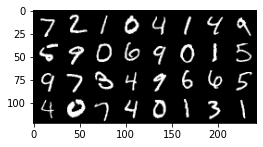

<Figure size 288x288 with 0 Axes>

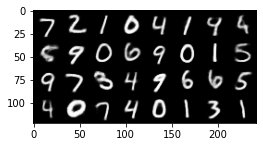

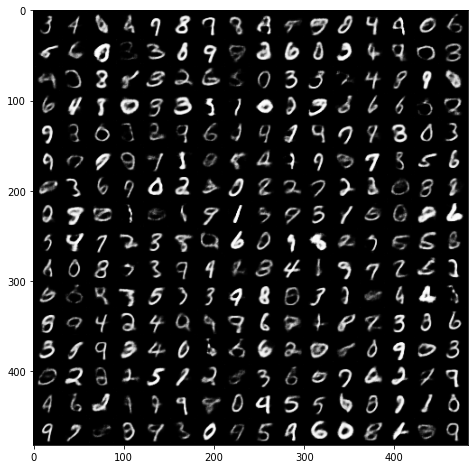

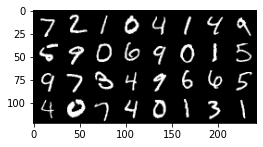

<Figure size 288x288 with 0 Axes>

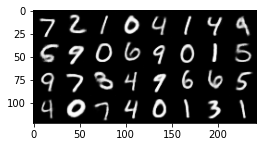

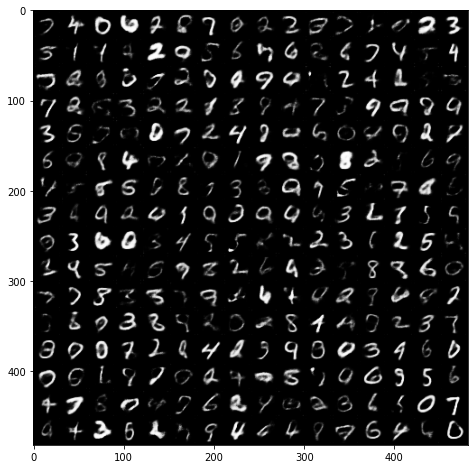

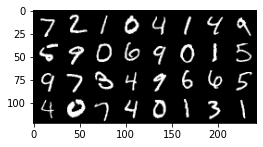

<Figure size 288x288 with 0 Axes>

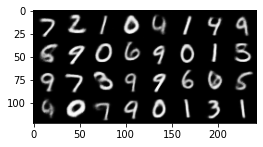

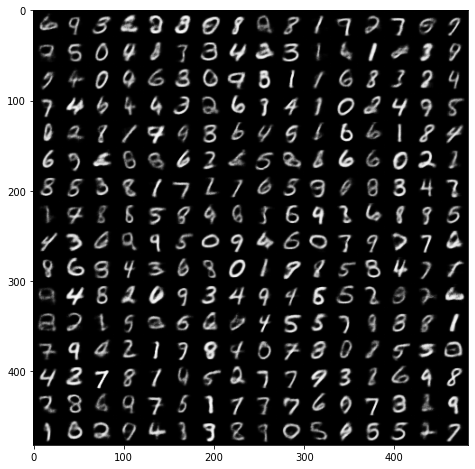

In [19]:
losses_beta = {}
betas = [2, 1, 0.5, 4]
for beta in betas:
    print('Beta is %s' % str(beta))
    model = VAE(latent_dim).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
    model, loss_list, kl_divergence_list, recon_loss_list, loss_test_list, kl_divergence_test_list, recon_loss_test_list = run_model(model, optimizer, beta, 1e-3, 20, 8)
    losses_beta[str(beta)] = [loss_list, kl_divergence_list, recon_loss_list, loss_test_list, kl_divergence_test_list, recon_loss_test_list]
    show_samples(model)

In [25]:
model = VAE(latent_dim).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
model, loss_list, kl_divergence_list, recon_loss_list, loss_test_list, kl_divergence_test_list, recon_loss_test_list = run_model(model, optimizer, 4, 5e-4, 30,8)

  0%|          | 0/469 [00:00<?, ?batch/s]/opt/conda/lib/python3.8/site-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))
100%|██████████| 79/79 [00:00<00:00, 105.60batch/s]


Input images
--------------------------------------------------
Reconstructed images
--------------------------------------------------
Generated Images
--------------------------------------------------


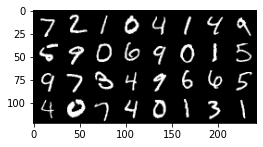

<Figure size 288x288 with 0 Axes>

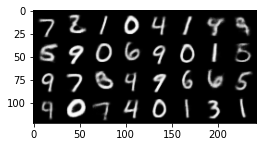

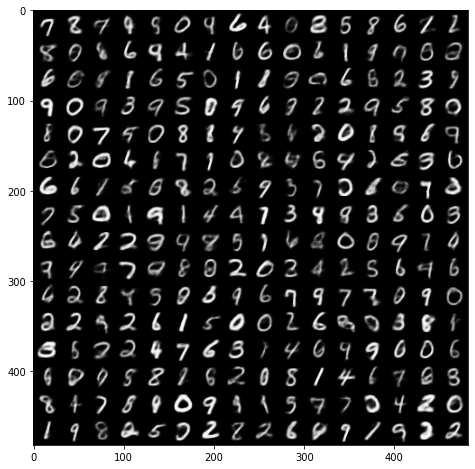

In [27]:
show_samples(model)

### Loss Curves

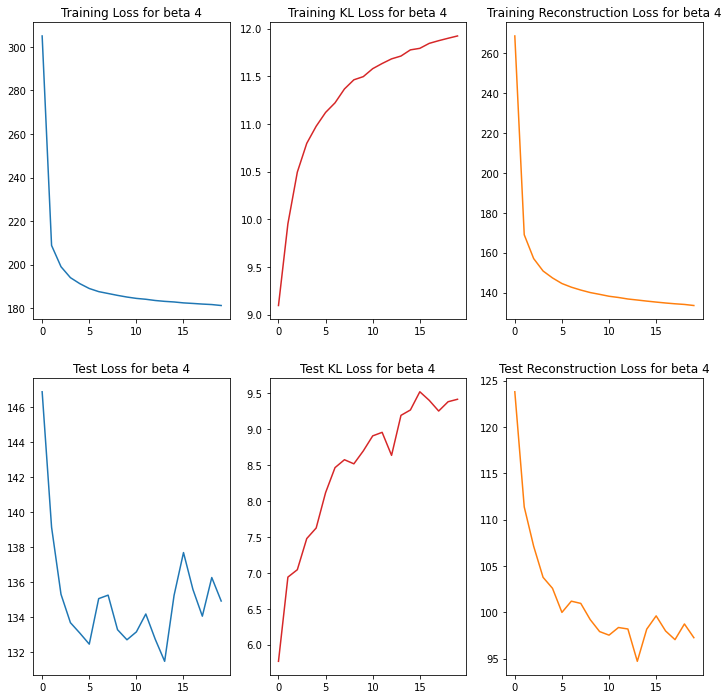

In [21]:
# *CODE FOR PART 1.2a IN THIS CELL*
from matplotlib.pyplot import figure
fig, axs = plt.subplots(2, 3)
y = np.arange(0,20)
axs[0, 0].plot(y, losses_beta['4'][0])
axs[0, 0].set_title('Training Loss for beta 4')
axs[0, 1].plot(y, losses_beta['4'][1], 'tab:red')
axs[0, 1].set_title('Training KL Loss for beta 4')
axs[0, 2].plot(y, losses_beta['4'][2], 'tab:orange')
axs[0, 2].set_title('Training Reconstruction Loss for beta 4')
axs[1, 0].plot(y, losses_beta['4'][3])
axs[1, 0].set_title('Test Loss for beta 4')
axs[1, 1].plot(y, losses_beta['4'][4],'tab:red')
axs[1, 1].set_title('Test KL Loss for beta 4')
axs[1, 2].plot(y, losses_beta['4'][5],'tab:orange')
axs[1, 2].set_title('Test Reconstruction Loss for beta 4')
plt.rcParams["figure.figsize"] = [12,12]
plt.show()

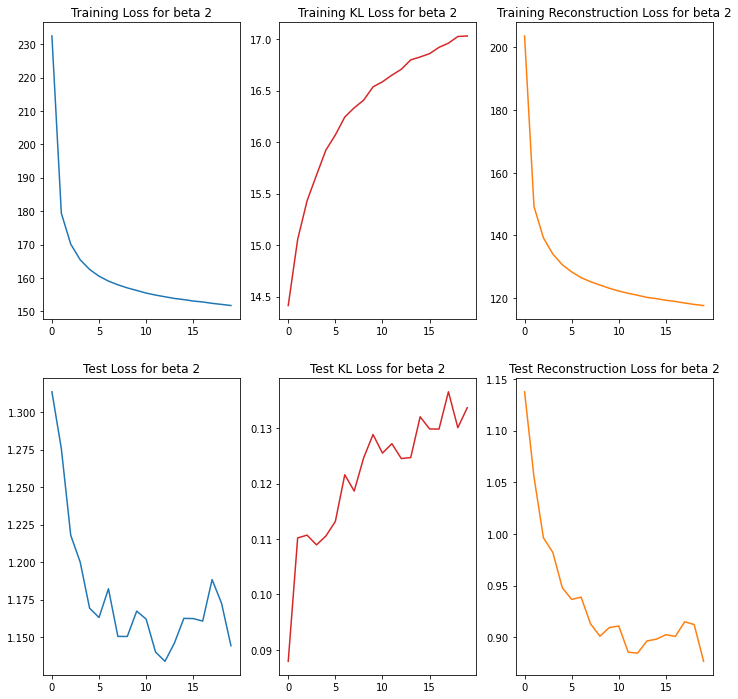

In [12]:
# *CODE FOR PART 1.2a IN THIS CELL*
from matplotlib.pyplot import figure
fig, axs = plt.subplots(2, 3)
y = np.arange(0,20)
axs[0, 0].plot(y, losses_beta['2'][0])
axs[0, 0].set_title('Training Loss for beta 2')
axs[0, 1].plot(y, losses_beta['2'][1], 'tab:red')
axs[0, 1].set_title('Training KL Loss for beta 2')
axs[0, 2].plot(y, losses_beta['2'][2], 'tab:orange')
axs[0, 2].set_title('Training Reconstruction Loss for beta 2')
axs[1, 0].plot(y, losses_beta['2'][3])
axs[1, 0].set_title('Test Loss for beta 2')
axs[1, 1].plot(y, losses_beta['2'][4],'tab:red')
axs[1, 1].set_title('Test KL Loss for beta 2')
axs[1, 2].plot(y, losses_beta['2'][5],'tab:orange')
axs[1, 2].set_title('Test Reconstruction Loss for beta 2')
plt.rcParams["figure.figsize"] = [12,12]
plt.show()

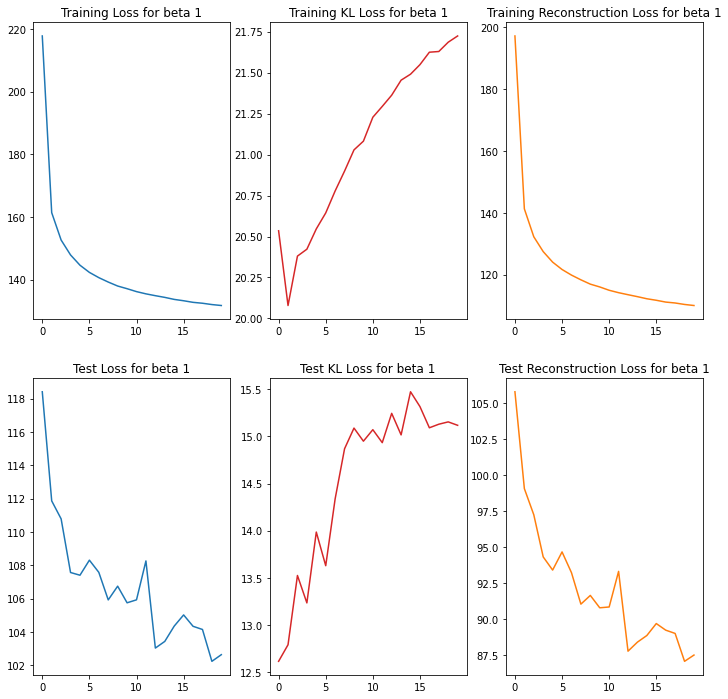

In [23]:
# *CODE FOR PART 1.2a IN THIS CELL*
from matplotlib.pyplot import figure
fig, axs = plt.subplots(2, 3)
y = np.arange(0,20)
axs[0, 0].plot(y, losses_beta['1'][0])
axs[0, 0].set_title('Training Loss for beta 1')
axs[0, 1].plot(y, losses_beta['1'][1], 'tab:red')
axs[0, 1].set_title('Training KL Loss for beta 1')
axs[0, 2].plot(y, losses_beta['1'][2], 'tab:orange')
axs[0, 2].set_title('Training Reconstruction Loss for beta 1')
axs[1, 0].plot(y, losses_beta['1'][3])
axs[1, 0].set_title('Test Loss for beta 1')
axs[1, 1].plot(y, losses_beta['1'][4],'tab:red')
axs[1, 1].set_title('Test KL Loss for beta 1')
axs[1, 2].plot(y, losses_beta['1'][5],'tab:orange')
axs[1, 2].set_title('Test Reconstruction Loss for beta 1')
plt.rcParams["figure.figsize"] = [12,12]
plt.show()

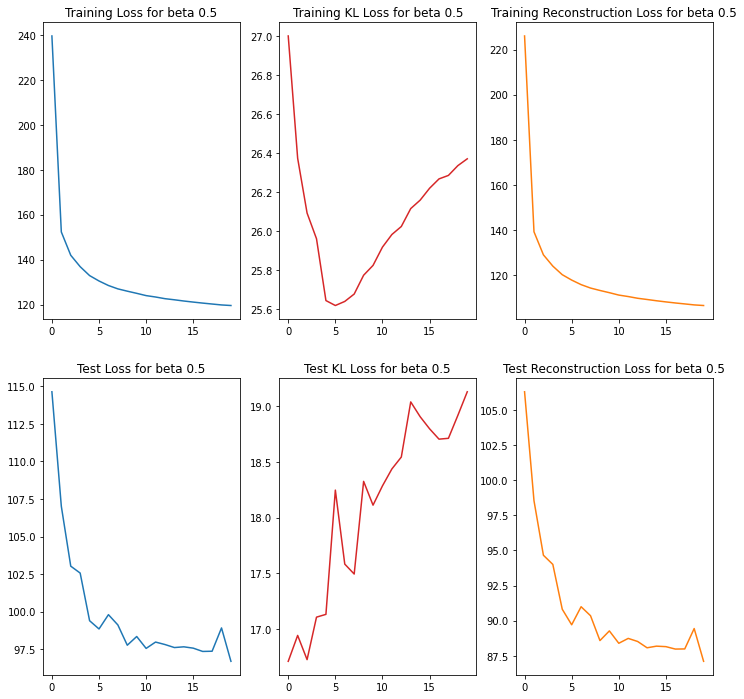

In [22]:
from matplotlib.pyplot import figure
fig, axs = plt.subplots(2, 3)
y = np.arange(0,20)
axs[0, 0].plot(y, losses_beta['0.5'][0])
axs[0, 0].set_title('Training Loss for beta 0.5')
axs[0, 1].plot(y, losses_beta['0.5'][1], 'tab:red')
axs[0, 1].set_title('Training KL Loss for beta 0.5')
axs[0, 2].plot(y, losses_beta['0.5'][2], 'tab:orange')
axs[0, 2].set_title('Training Reconstruction Loss for beta 0.5')
axs[1, 0].plot(y, losses_beta['0.5'][3])
axs[1, 0].set_title('Test Loss for beta 0.5')
axs[1, 1].plot(y, losses_beta['0.5'][4],'tab:red')
axs[1, 1].set_title('Test KL Loss for beta 0.5')
axs[1, 2].plot(y, losses_beta['0.5'][5],'tab:orange')
axs[1, 2].set_title('Test Reconstruction Loss for beta 0.5')
plt.rcParams["figure.figsize"] = [12,12]
plt.show()

## Samples and Reconstructions


In [18]:

def show_samples(model):
    # load the model
    print('Input images')
    print('-'*50)

    sample_inputs, _ = next(iter(loader_test))
    fixed_input = sample_inputs[0:32, :, :, :]
    # visualize the original images of the last batch of the test set
    img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                    range=None, scale_each=False, pad_value=0)
    plt.figure()
    show(img)

    print('Reconstructed images')
    print('-'*50)
    with torch.no_grad():
        # visualize the reconstructed images of the last batch of test set

        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        recon_batch, _, _ = model.forward(fixed_input.to(device=device))
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 

        recon_batch = recon_batch.cpu()
        recon_batch = make_grid(denorm(recon_batch), nrow=8, padding=2, normalize=False,
                                range=None, scale_each=False, pad_value=0)
        plt.figure()
        plt.figure(figsize = (4,4))
        plt.rcParams["figure.figsize"] = [4,4]
        show(recon_batch)

    print('Generated Images')  
    print('-'*50)
    model.eval()
    n_samples = 256
    z = torch.randn(n_samples,8).to(device)
    with torch.no_grad():
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        samples = model.decode(z.to(device=device))
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 

        samples = samples.cpu()
        samples = make_grid(denorm(samples), nrow=16, padding=2, normalize=False,
                                range=None, scale_each=False, pad_value=0)
        plt.figure(figsize = (8,8))
        show(samples)



Input images
--------------------------------------------------
Reconstructed images
--------------------------------------------------
Generated Images
--------------------------------------------------


/opt/conda/lib/python3.8/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


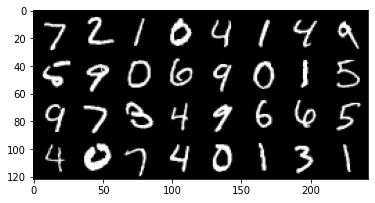

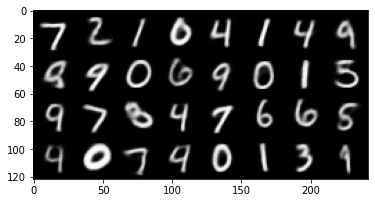

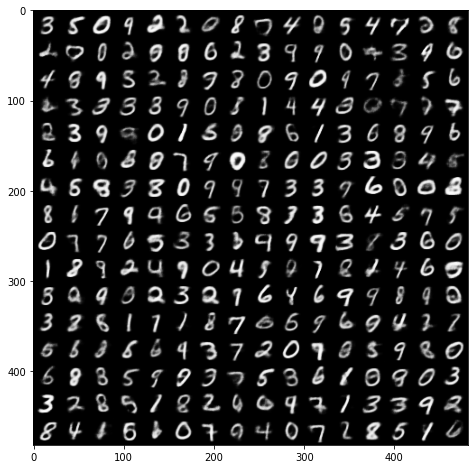

In [12]:

show_samples(model)

In [8]:
#Latent space for beta 0.5
from sklearn.manifold import TSNE
from collections import defaultdict
# model = VAE(8).to(device)
# model_dict=torch.load(content_path/'VAE/VAE_model0.5losses.pth')
# state_dict = model_dict.state_dict()
# model.load_state_dict(state_dict)
# model.eval()
def latent_space_plot(model):
    test_dat_eval = torch.Tensor(np.array([datum[0].detach().numpy() for datum in test_dat])).to(device=device)
    test_label = np.array([datum[1] for datum in test_dat])

    z = []
    with tqdm.tqdm(loader_test, unit="batch") as tepoch: 
                for batch_idx, (test_data, _) in enumerate(tepoch):
                    test_data = test_data[0][None, :, :].to(device=device)
                    out_test = model.encode(test_data)
                    z.append(out_test[0].cpu().detach().numpy())

    z = torch.tensor(np.array(z))
    z = model.encode(test_dat_eval)
    z_embedded = TSNE(n_components=2, learning_rate='auto',
                      init='random').fit_transform(z[0].cpu().detach().numpy())
    
    embed_labels = defaultdict(list)
    for i in range(len(z_embedded)):
        embed_labels[str(test_label[i])].append(z_embedded[i])

    plt.rcParams["figure.figsize"] = [12,12]
    for label in embed_labels.keys():
        x = [dat[0] for dat in embed_labels[label]]
        y = [dat[1] for dat in embed_labels[label]]
        plt.scatter(x, y, label = str(label))
    plt.legend(loc="best")
    plt.show()
        
        

In [ ]:
# *CODE FOR PART 1.3a IN THIS CELL
from collections import defaultdict
test_dat_eval = torch.Tensor(np.array([datum[0].detach().numpy() for datum in test_dat])).to(device=device)
test_label = np.array([datum[1] for datum in test_dat])
z = model.encode(test_dat_eval)
z_embedded = TSNE(n_components=2, learning_rate='auto',
                  init='random').fit_transform(z[0].cpu().detach().numpy())
embed_labels = defaultdict(list)
for i in range(len(z_embedded)):
    embed_labels[str(test_label[i])].append(z_embedded[i])

Latent Space for Beta 4

/opt/conda/lib/python3.8/site-packages/torch/serialization.py:602: UserWarning: 'torch.load' received a zip file that looks like a TorchScript archive dispatching to 'torch.jit.load' (call 'torch.jit.load' directly to silence this warning)
  warnings.warn("'torch.load' received a zip file that looks like a TorchScript archive"
100%|██████████| 79/79 [00:04<00:00, 17.20batch/s]


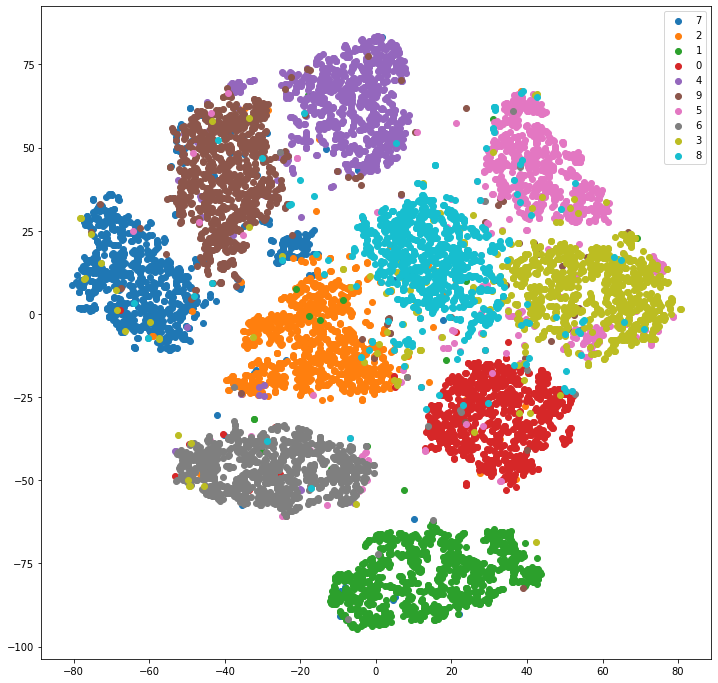

In [9]:
model = VAE(8).to(device)
model_dict=torch.load(content_path/'VAE/VAE_model.pth')
state_dict = model_dict.state_dict()
model.load_state_dict(state_dict)
model.eval()
latent_space_plot(model)

Latent Space for Beta 0.5

/opt/conda/lib/python3.8/site-packages/torch/serialization.py:602: UserWarning: 'torch.load' received a zip file that looks like a TorchScript archive dispatching to 'torch.jit.load' (call 'torch.jit.load' directly to silence this warning)
  warnings.warn("'torch.load' received a zip file that looks like a TorchScript archive"
100%|██████████| 79/79 [00:03<00:00, 24.33batch/s]


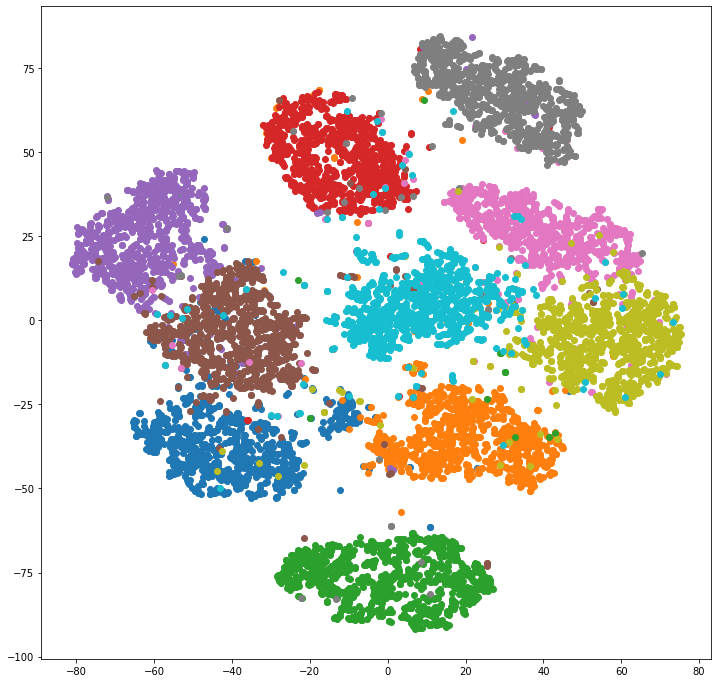

In [10]:
model = VAE(8).to(device)
model_dict=torch.load(content_path/'VAE/VAE_model0.5lossesfinal.pth')
state_dict = model_dict.state_dict()
model.load_state_dict(state_dict)
model.eval()
latent_space_plot(model)

Latent Space for Beta 1

/opt/conda/lib/python3.8/site-packages/torch/serialization.py:602: UserWarning: 'torch.load' received a zip file that looks like a TorchScript archive dispatching to 'torch.jit.load' (call 'torch.jit.load' directly to silence this warning)
  warnings.warn("'torch.load' received a zip file that looks like a TorchScript archive"
100%|██████████| 79/79 [00:00<00:00, 98.67batch/s] 


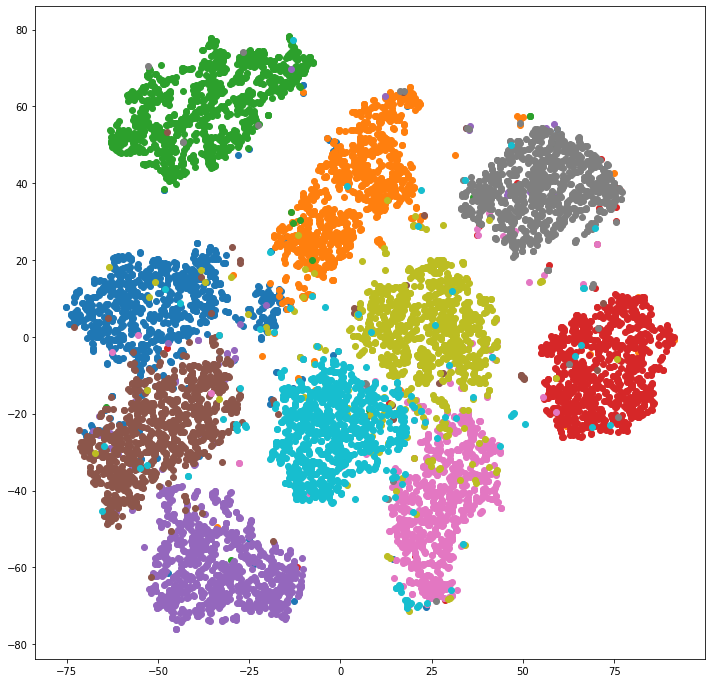

In [11]:
model = VAE(8).to(device)
model_dict=torch.load(content_path/'VAE/VAE_model1lossesfinal.pth')
state_dict = model_dict.state_dict()
model.load_state_dict(state_dict)
model.eval()
latent_space_plot(model)

In [8]:
# Interactive Visualization - Code Provided
import icl_dl_cw2_utils
import imp
imp.reload(icl_dl_cw2_utils)
from icl_dl_cw2_utils.utils.plotting import plot_tsne
from sklearn.manifold import TSNE
test_dataloader = DataLoader(test_dat, 10000, shuffle=False)
""" Inputs to the function are
        z_embedded - Embedded X, Y positions for every point in test_dataloader
        test_dataloader - dataloader with batchsize set to 10000
        num_points - number of points plotted (will slow down with >1k)
"""
model = VAE(8).to(device)
model_dict=torch.load(content_path/'VAE/VAE_model.pth')
state_dict = model_dict.state_dict()
model.load_state_dict(state_dict)
model.eval()
data, _ = next(iter(test_dataloader))
data = data.to(device=device)
z = model.encode(data)
z_embedded = TSNE(n_components=2, learning_rate='auto',
                  init='random').fit_transform(z[0].cpu().detach().numpy())
icl_dl_cw2_utils.utils.plotting.plot_tsne(z_embedded, test_dataloader, num_points=1000, darkmode=False)


/opt/conda/lib/python3.8/site-packages/torch/serialization.py:602: UserWarning: 'torch.load' received a zip file that looks like a TorchScript archive dispatching to 'torch.jit.load' (call 'torch.jit.load' directly to silence this warning)
  warnings.warn("'torch.load' received a zip file that looks like a TorchScript archive"


alt.HConcatChart(...)

Link for TSNE plot in case it doesn't load: https://drive.google.com/file/d/1anFwvRuKjqmEZyl93KXsa8Qx0rW7Xj3c/view?usp=sharing

## Interpolation in $z$

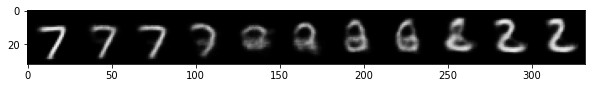

In [42]:
# CODE FOR PART 1.3b IN THIS CELL
data, label = next(iter(loader_test))
data1 = data[0]
label1 = label[0]
for i in range(len(label)):
    if label[i] != label1:
        data2 = data[i]
        label2 = label[i]
        break

mixing_factor = 0.1
imgs = []
for i in range(11):
    inter = data1*(1-mixing_factor*i) + data2*mixing_factor*i
    img, _, _ = model.forward(inter[None, :].to(device=device))
    imgs.append(np.squeeze(img, 0))

sample = make_grid(imgs, nrow = 11)
plt.figure(figsize = (10,16))
show(sample)

# Deep Convolutional GAN

In [11]:
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.utils.data import sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
from torch.optim.lr_scheduler import StepLR, MultiStepLR
import torch.nn.functional as F
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

mean = torch.Tensor([0.4914, 0.4822, 0.4465])
std = torch.Tensor([0.247, 0.243, 0.261])
unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

def denorm(x, channels=None, w=None ,h=None, resize = False):
#     scaler = MinMaxScaler((-1,1))
#     scaler.fit(x)
    x = unnormalize(x)
#     x = scaler.transform(x)
    if resize:
        if channels is None or w is None or h is None:
            print('Number of channels, width and height must be provided for resize.')
        x = x.view(x.size(0), channels, w, h)
    return x

def show(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))

if not os.path.exists(content_path/'GAN'):
    os.makedirs(content_path/'GAN')

GPU = True # Choose whether to use GPU
if GPU:
    device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")
else:
    device = torch.device("cpu")
print(f'Using {device}')

# We set a random seed to ensure that your results are reproducible.
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

Using cuda


#### Data loading

In [12]:
batch_size = 64

transform = transforms.Compose([
     transforms.ToTensor(),
     transforms.Normalize(mean=mean, std=std),                        
])
# note - data_path was initialized at the top of the notebook
cifar10_train = datasets.CIFAR10(data_path, train=True, download=True, transform=transform)
cifar10_test = datasets.CIFAR10(data_path, train=False, download=True, transform=transform)
loader_train = DataLoader(cifar10_train, batch_size=batch_size)
loader_test = DataLoader(cifar10_test, batch_size=batch_size)

Files already downloaded and verified
Files already downloaded and verified


We'll visualize a subset of the test set: 

/opt/conda/lib/python3.8/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


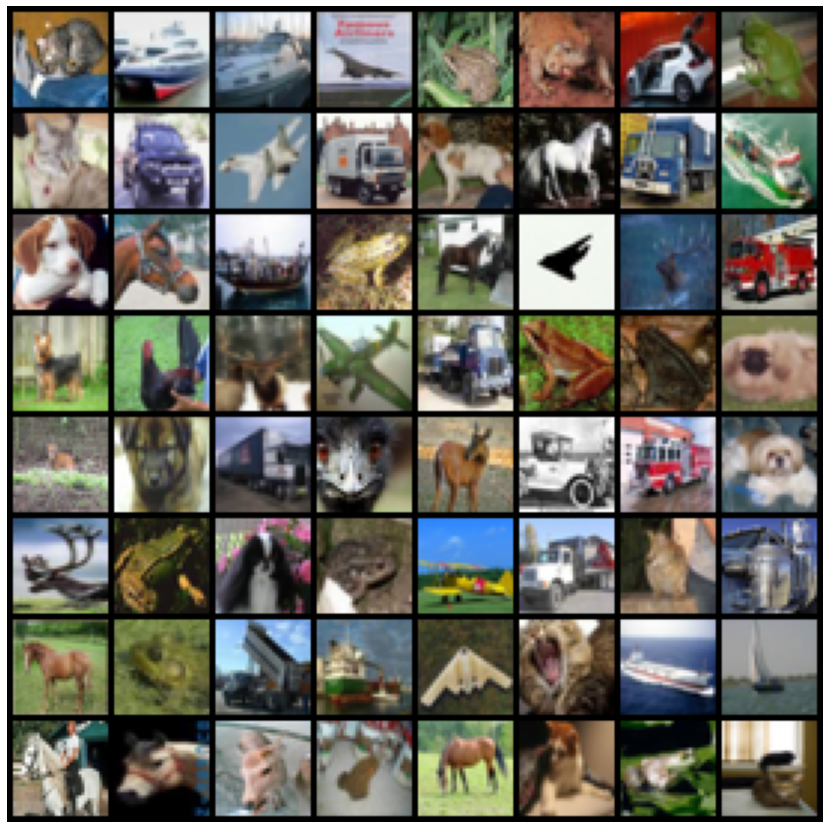

In [13]:
samples, _ = next(iter(loader_test))

samples = samples.cpu()
samples = make_grid(denorm(samples), nrow=8, padding=2, normalize=False,
                        range=None, scale_each=False, pad_value=0)
plt.figure(figsize = (15,15))
plt.axis('off')
show(samples)

#### Model Definition
Define hyperparameters and the model

In [14]:
num_epochs = 60
learning_rate = 0.0002
latent_vector_size = 100
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

In [15]:
# *CODE FOR PART 2.1 IN THIS CELL*
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 16, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 2, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )
       
    def forward(self, z):
        out = self.main(z)
        return out


class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf * 2, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf*2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        ) 
        
    def forward(self, x):
        out = self.main(x)
        return out


<h2> Initialize Model and print number of parameters </h2>

In [16]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

In [17]:
use_weights_init = True

model_G = Generator().to(device)
if use_weights_init:
    model_G.apply(weights_init)
params_G = sum(p.numel() for p in model_G.parameters() if p.requires_grad)
print("Total number of parameters in Generator is: {}".format(params_G))
print(model_G)
print('\n')

model_D = Discriminator().to(device)
if use_weights_init:
    model_D.apply(weights_init)
params_D = sum(p.numel() for p in model_D.parameters() if p.requires_grad)
print("Total number of parameters in Discriminator is: {}".format(params_D))
print(model_D)
print('\n')

print("Total number of parameters is: {}".format(params_G + params_D))

Total number of parameters in Generator is: 6365952
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)


Total number of parameters in Discriminator is: 2637312
Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding

#### Defining a Loss

In [18]:
def loss_function(out, label):
    return F.binary_cross_entropy(out, label)

<h3>Choose and initialize optimizers</h3>

In [19]:
beta1 = 0.5
optimizerD = torch.optim.Adam(model_D.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizerG = torch.optim.Adam(model_G.parameters(), lr=learning_rate, betas=(beta1, 0.999))


<h3> Define fixed input vectors to monitor training and mode collapse. </h3>

In [20]:
fixed_noise = torch.randn(batch_size, 100, 1, 1, device=device)

#### Training Loop

In [ ]:
train_losses_G = []
train_losses_D = []


for epoch in range(num_epochs):

    with tqdm.tqdm(loader_train, unit="batch") as tepoch: 
        for i, (data, _) in enumerate(tepoch):
            train_loss_D = 0
            train_loss_G = 0
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            model_D.zero_grad()
            # train with real
            real_cpu = data.to(device)

            r_size = real_cpu.size(0)
            label = torch.full((r_size,), 1, dtype=torch.float, device=device)
            out_real = model_D(real_cpu).view(-1)
            err_real = loss_function(out_real, label)
            
            err_real.backward()
        
            D_x = out_real.mean().item()
            # train with fake
            noise = torch.randn(r_size, 100, 1, 1, device=device)
            
            fake = model_G(noise)
            label.fill_(0)
            out_fake = model_D(fake.detach()).view(-1)
            
            errD_fake = loss_function(out_fake, label)
            errD_fake.backward()
            D_G_z1 = out_fake.mean().item()
            errD = err_real + errD_fake
            train_loss_D += errD
            optimizerD.step()
            # (2) Update G network: maximize log(D(G(z)))

            model_G.zero_grad()
            label.fill_(1)
            out = model_D(fake).view(-1)
            
            errG = loss_function(out, label)
            train_loss_G += errG
            errG.backward()
            D_G_z2 = out.mean().item()
            optimizerG.step()

            # Logging 
            if i % 50 == 0:
                tepoch.set_description(f"Epoch {epoch}")
                tepoch.set_postfix(D_G_z=f"{D_G_z1:.3f}/{D_G_z2:.3f}", D_x=D_x,
                                  Loss_D=errD.item(), Loss_G=errG.item())

    if epoch == 0:
        save_image(denorm(real_cpu.cpu()).float(), content_path/'GAN/real_samples.png')
    if epoch %10 == 0:
      generated = model_G(fixed_noise).cpu()
      generated = make_grid(generated[:100], nrow=10, padding=2, normalize=True, 
                          range=None, scale_each=False, pad_value=0)
      plt.figure(figsize=(15,15))

      show(generated)
    with torch.no_grad():
        fake = model_G(fixed_noise)
        image_name = 'GAN/fake_samples_epoch_%03d.png' % epoch
        save_image(denorm(fake.cpu()).float(), content_path/image_name)
    train_losses_D.append(train_loss_D / len(loader_train))
    train_losses_G.append(train_loss_G / len(loader_train))
    
# save  models 
torch.jit.save(torch.jit.trace(model_G, (fixed_noise)), content_path/'GAN/GAN_G_modelretry60.pth')
torch.jit.save(torch.jit.trace(model_D, (fake)), content_path/'GAN/GAN_D_modelretry60.pth')

Epoch 49: 100%|██████████| 782/782 [01:05<00:00, 11.87batch/s, D_G_z=0.699/0.190, D_x=0.962, Loss_D=0.709, Loss_G=2.06] 


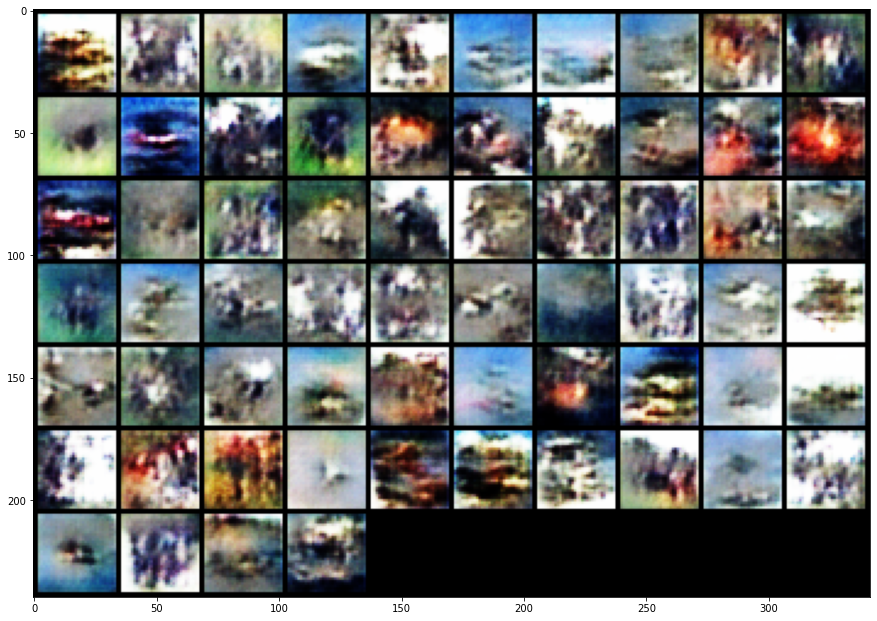

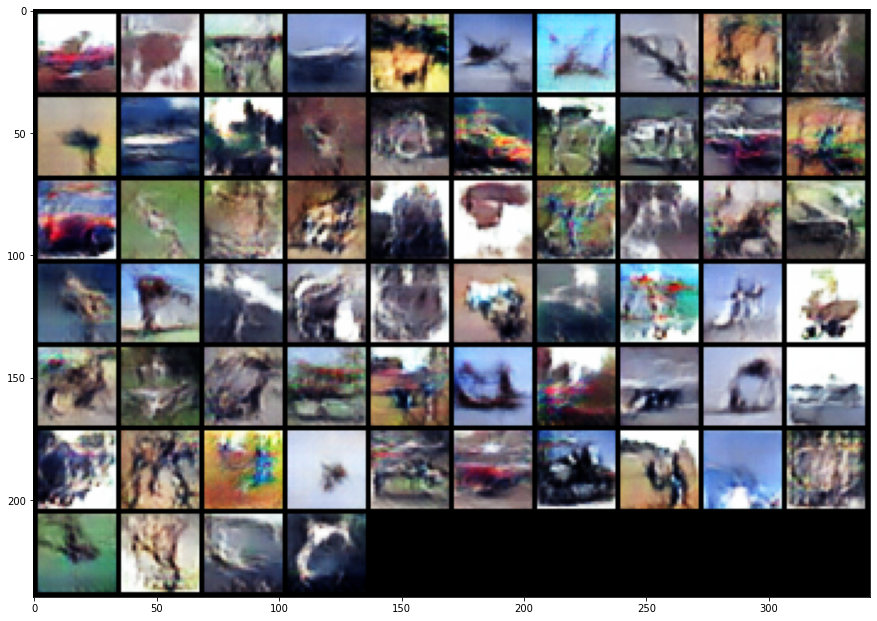

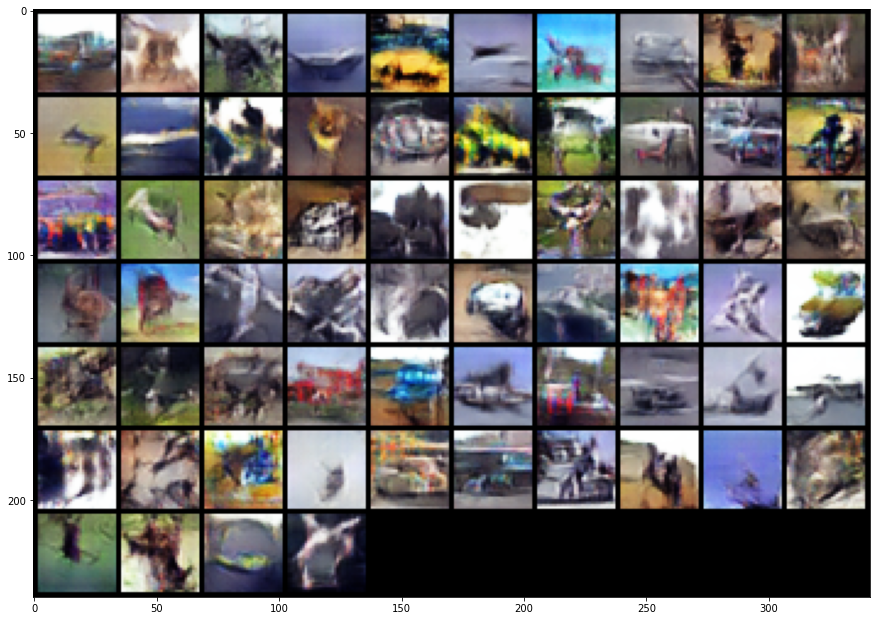

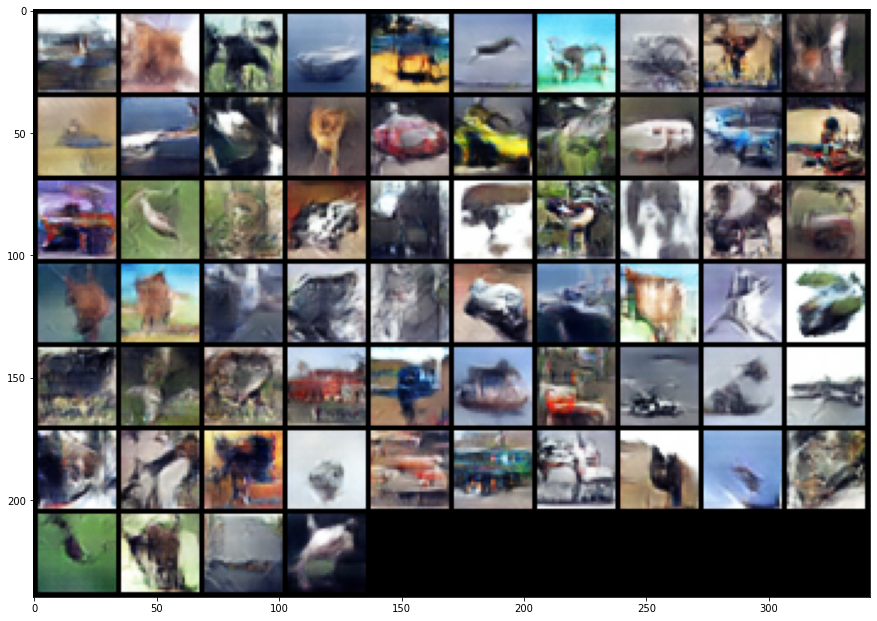

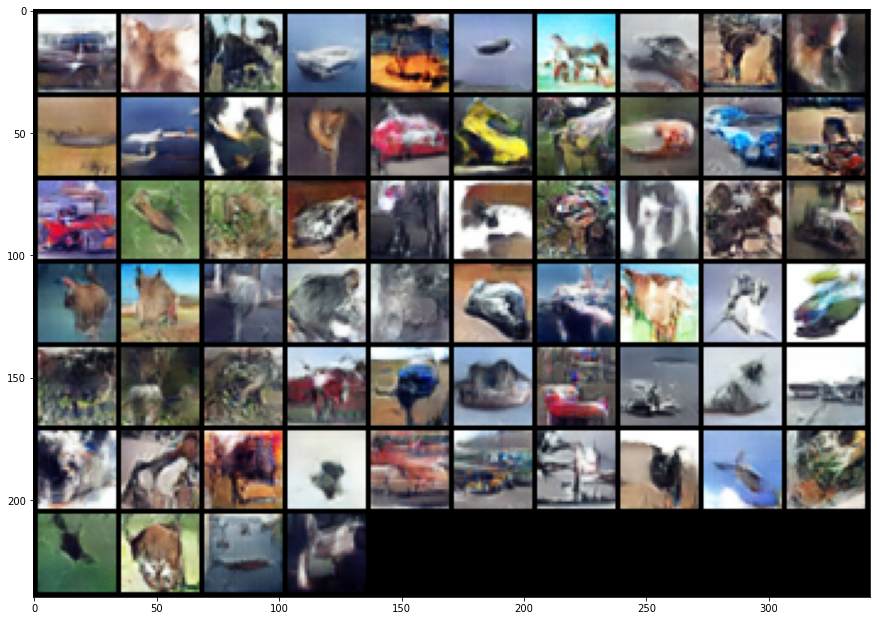

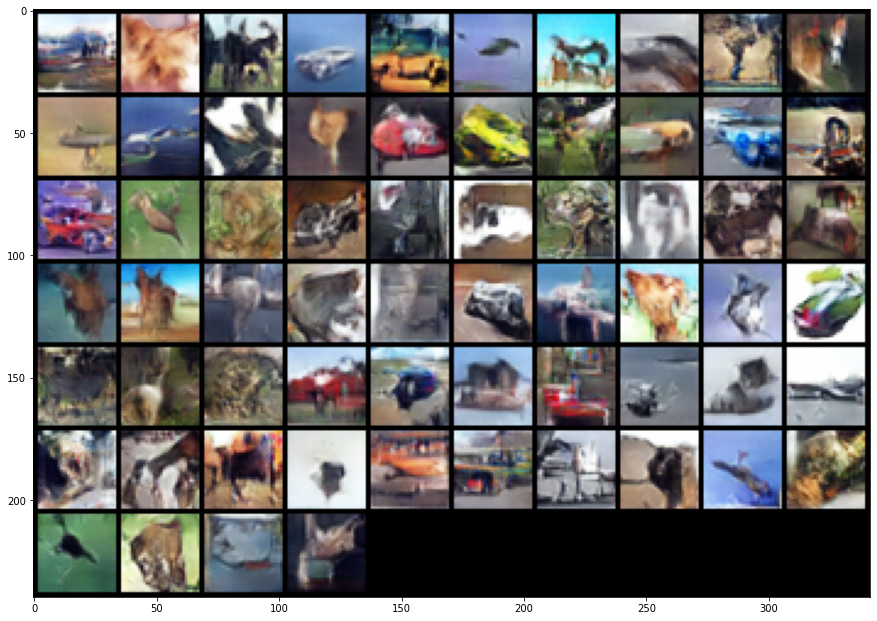

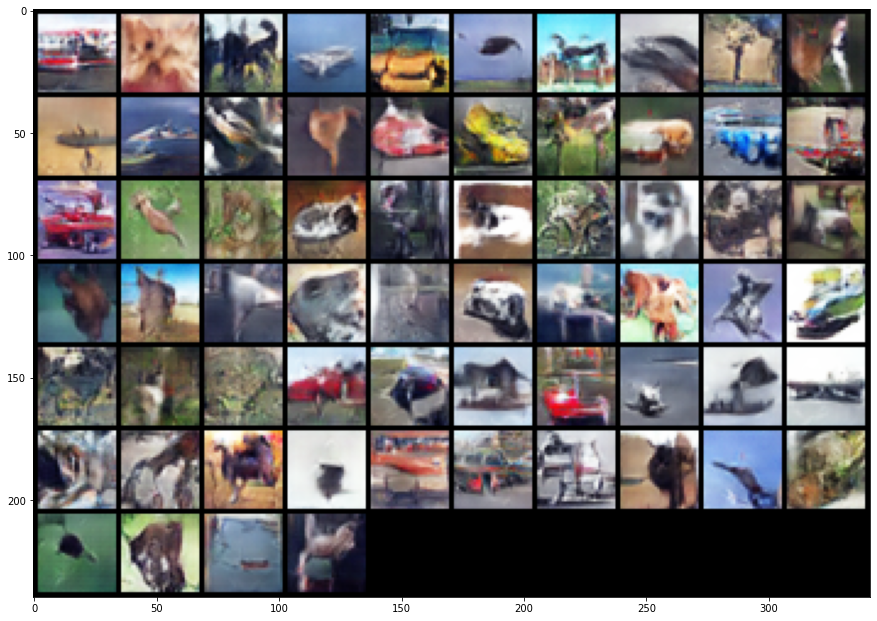

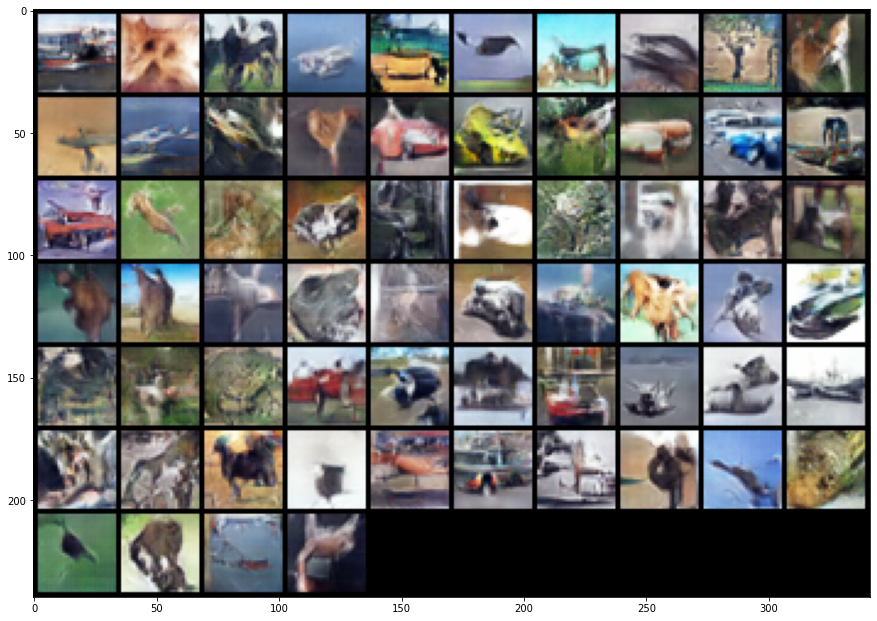

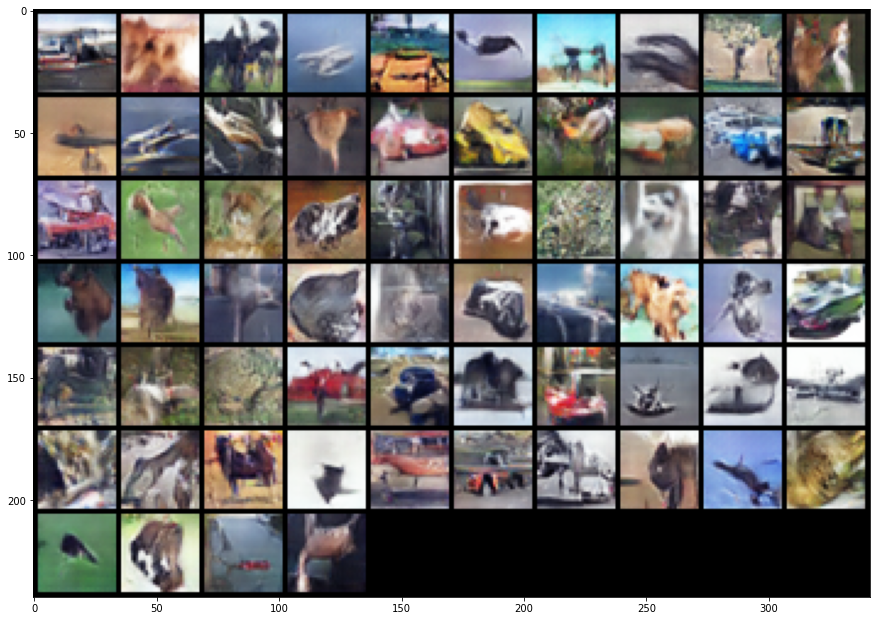

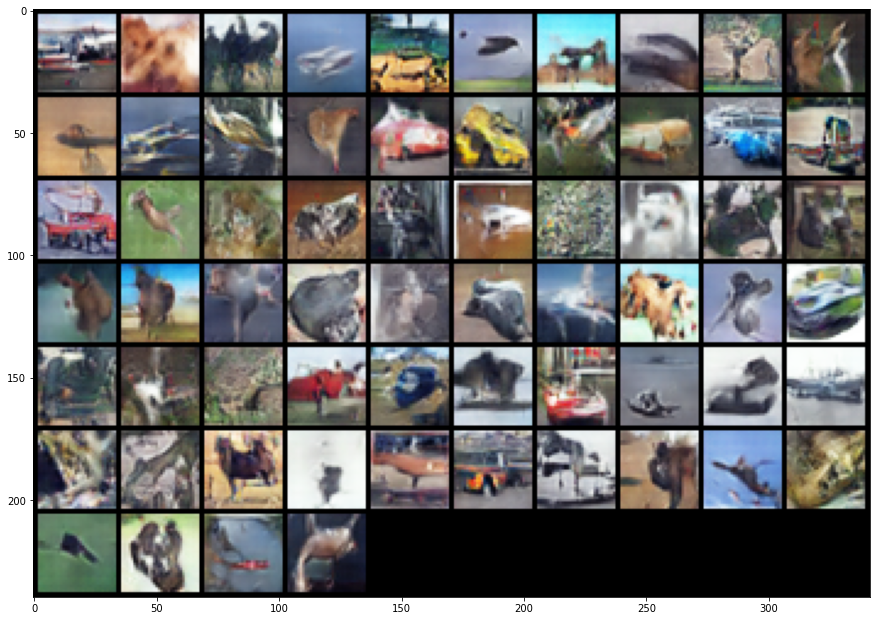

In [19]:
train_losses_G = []
train_losses_D = []

for epoch in range(num_epochs):
    with tqdm.tqdm(loader_train, unit="batch") as tepoch: 
        for i, (data, _) in enumerate(tepoch):
            train_loss_D = 0
            train_loss_G = 0
            
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            model_D.zero_grad()
            # train with real
            real_cpu = data.to(device)

            r_size = real_cpu.size(0)
            label = torch.full((r_size,), np.random.uniform(0.7, 1.2), dtype=torch.float, device=device)
            out_real = model_D(real_cpu).view(-1)
            err_real = loss_function(out_real, label)
            
            err_real.backward()
            
            D_x = out_real.mean().item()
            # train with fake
            noise = torch.randn(r_size, 100, 1, 1, device=device)
            
            fake = model_G(noise)
            label.fill_(np.random.uniform(0, 0.3))
            out_fake = model_D(fake.detach()).view(-1)
            
            errD_fake = loss_function(out_fake, label)
            errD_fake.backward()
            D_G_z1 = out_fake.mean().item()
            errD = err_real + errD_fake
            train_loss_D += errD
            optimizerD.step()
            # (2) Update G network: maximize log(D(G(z)))

            model_G.zero_grad()
            label.fill_(np.random.uniform(0.7, 1.2))
            out = model_D(fake).view(-1)
            
            errG = loss_function(out, label)
            train_loss_G += errG
            errG.backward()
            D_G_z2 = out.mean().item()
            optimizerG.step()
            # Logging 
            if i % 50 == 0:
                tepoch.set_description(f"Epoch {epoch}")
                tepoch.set_postfix(D_G_z=f"{D_G_z1:.3f}/{D_G_z2:.3f}", D_x=D_x,
                                  Loss_D=errD.item(), Loss_G=errG.item())

    if epoch == 0:
        save_image(denorm(real_cpu.cpu()).float(), content_path/'GAN/real_samples.png')
    if epoch %5 == 0:
      generated = model_G(fixed_noise).cpu()
      generated = make_grid(generated[:100], nrow=10, padding=2, normalize=True, 
                          range=None, scale_each=False, pad_value=0)
      plt.figure(figsize=(15,15))
      show(generated)
    with torch.no_grad():
        fake = model_G(fixed_noise)
        image_name = 'GAN/fake_samples_epoch_%03d.png' % epoch
        save_image(denorm(fake.cpu()).float(), content_path/image_name)
    train_losses_D.append(train_loss_D / len(loader_train))
    train_losses_G.append(train_loss_G / len(loader_train))
    
torch.jit.save(torch.jit.trace(model_G, (fixed_noise)), content_path/'GAN/GAN_G_modelbiggersoftforreal.pth')
torch.jit.save(torch.jit.trace(model_D, (fake)), content_path/'GAN/GAN_D_modelbiggersoftforreal.pth')

### Generator samples

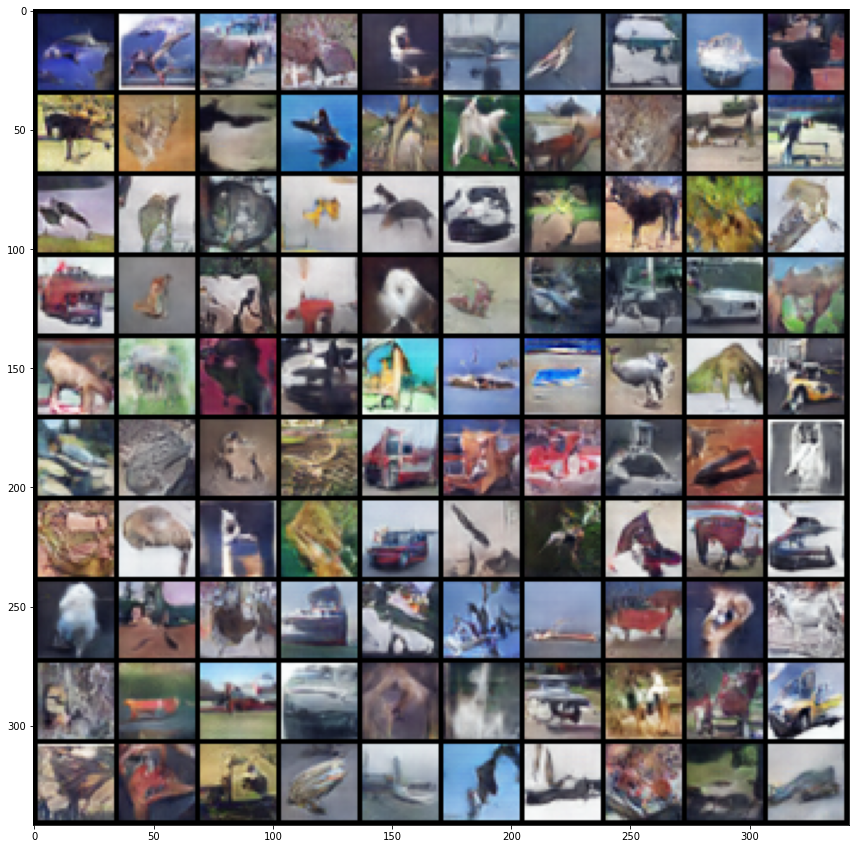

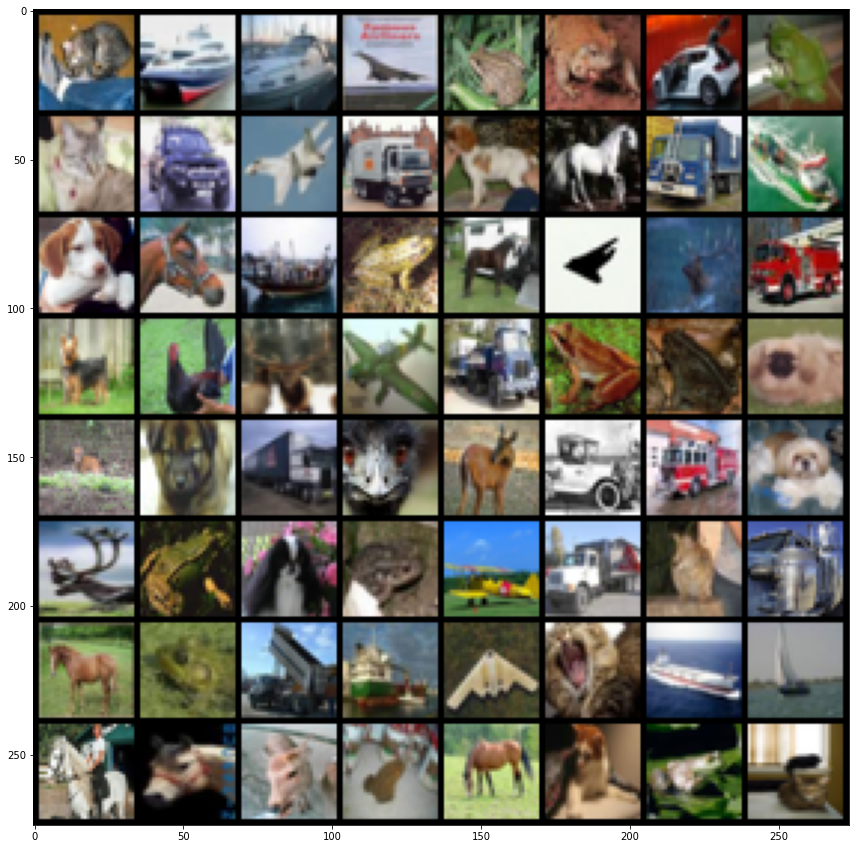

In [26]:
input_noise = torch.randn(100, 100, 1, 1, device=device)
model_G = Generator().to(device)
model_dict=torch.load(content_path/'GAN/GAN_G_modelretry60.pth')
state_dict = model_dict.state_dict()
model_G.load_state_dict(state_dict)
model_G.eval()
with torch.no_grad():
    # visualize the generated images
    generated = model_G(input_noise).cpu()
    generated = make_grid(generated, nrow=10, padding=2, normalize=True, 
                        range=None, scale_each=False, pad_value=0)
    plt.figure(figsize=(15,15))
    save_image(generated, content_path/'GAN/Teaching_final.png')
    show(generated) # note these are now class conditional images columns rep classes 1-10

it = iter(loader_test)
sample_inputs, _ = next(it)
fixed_input = sample_inputs[0:64, :, :, :]
# visualize the original images of the last batch of the test set for comparison
img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                range=None, scale_each=False, pad_value=0)
plt.figure(figsize=(15,15))
show(img)

### Loss Curves

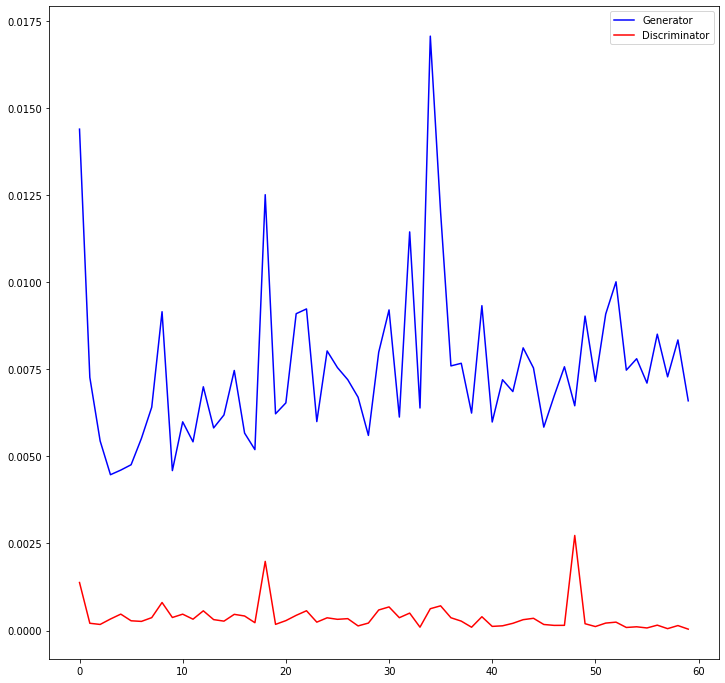

In [50]:
G_loss = [it.cpu().detach().numpy() for it in train_losses_G]
D_loss = [it.cpu().detach().numpy() for it in train_losses_D]
plt.plot(G_loss, "-b", label="Generator")
plt.plot(D_loss, "-r", label="Discriminator")
plt.legend(loc="best")
plt.rcParams["figure.figsize"] = [15,15]

plt.show()